# Исследование объявлений о продаже квартир

В вашем распоряжении данные сервиса Яндекс.Недвижимость — архив объявлений о продаже квартир в Санкт-Петербурге и соседних населённых пунктов за несколько лет. Нужно научиться определять рыночную стоимость объектов недвижимости. Ваша задача — установить параметры. Это позволит построить автоматизированную систему: она отследит аномалии и мошенническую деятельность. 

По каждой квартире на продажу доступны два вида данных. Первые вписаны пользователем, вторые — получены автоматически на основе картографических данных. Например, расстояние до центра, аэропорта, ближайшего парка и водоёма. 

Для начала давайте выдвенем некоторые гипотезы. 
Санкт-Петербург второй по численности город в Росссии, город в который приезжает множество людей каждый год, город в котором есть множество возможностей, которых нет во многих городах России. Здесь находятся ведущие университеты России. Так же в Санкт-Петербурге сочетаются спальные районы с большими жилыми комплексами, состоящими из многоэтажных домов и 3-5 этажные дома в центре города, где тоже живут люди. В Санкт-Петербурге очень много местных жителей, которые живут семьями в 2-3 комнатных квартирах, но так же очень много приезжих, особенно студентов, которые предпочитают студии и однокомнатные квартиры. Могу предположить, что стоимость квартиры достаточно сильно будет зависеть от расположения, количества комнат и жилой площади. Цена за квадратный метр будет больше всего в центре города, а с удалением от центра будет уменьшаться, цена в пригороде будет ниже, чем в целом по Санкт-Петербургу. 

### Шаг 1. Откроем файл с данными и изучим общую информацию. 

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
data=pd.read_csv('/datasets/real_estate_data.csv')
print(data.head())#смотрим наш датасет

  total_images\tlast_price\ttotal_area\tfirst_day_exposition\trooms\tceiling_height\tfloors_total\tliving_area\tfloor\tis_apartment\tstudio\topen_plan\tkitchen_area\tbalcony\tlocality_name\tairports_nearest\tcityCenters_nearest\tparks_around3000\tparks_nearest\tponds_around3000\tponds_nearest\tdays_exposition
0  20\t13000000.0\t108.0\t2019-03-07T00:00:00\t3\...                                                                                                                                                                                                                                                                  
1  7\t3350000.0\t40.4\t2018-12-04T00:00:00\t1\t\t...                                                                                                                                                                                                                                                                  
2  10\t5196000.0\t56.0\t2015-08-20T00:00:00\t2\t\...               

Видим, что в датасете данные разделены непривычным способом, с помощью \t. Прочитаем датасет с учетом этого


In [2]:
data=pd.read_csv('/datasets/real_estate_data.csv', sep='\t')
print(data.head())
data.info()

   total_images  last_price  total_area first_day_exposition  rooms  \
0            20  13000000.0       108.0  2019-03-07T00:00:00      3   
1             7   3350000.0        40.4  2018-12-04T00:00:00      1   
2            10   5196000.0        56.0  2015-08-20T00:00:00      2   
3             0  64900000.0       159.0  2015-07-24T00:00:00      3   
4             2  10000000.0       100.0  2018-06-19T00:00:00      2   

   ceiling_height  floors_total  living_area  floor is_apartment  ...  \
0            2.70          16.0         51.0      8          NaN  ...   
1             NaN          11.0         18.6      1          NaN  ...   
2             NaN           5.0         34.3      4          NaN  ...   
3             NaN          14.0          NaN      9          NaN  ...   
4            3.03          14.0         32.0     13          NaN  ...   

   kitchen_area  balcony    locality_name  airports_nearest  \
0          25.0      NaN  Санкт-Петербург           18863.0   
1       


Теперь данные считаны корректно и мы можем начать с ними работать. В таблице 22 колонки и в некоторых из них сразу видно наличие пропусков. С этого и начнем переработку данных. Но давайте еще сразу взглянем на данные методом describe, чтобы посмотреть в каких столбцах следует поискать аномалии.


In [3]:
data.describe()

,total_images,last_price,total_area,rooms,ceiling_height,floors_total,living_area,floor,kitchen_area,balcony,airports_nearest,cityCenters_nearest,parks_around3000,parks_nearest,ponds_around3000,ponds_nearest,days_exposition
count,23699.000000,2.369900e+04,23699.000000,23699.000000,14504.000000,23613.000000,21796.000000,23699.000000,21421.000000,12180.000000,18157.000000,18180.000000,18181.000000,8079.000000,18181.000000,9110.000000,20518.000000
mean,9.858475,6.541549e+06,60.348651,2.070636,2.771499,10.673824,34.457852,5.892358,10.569807,1.150082,28793.672193,14191.277833,0.611408,490.804555,0.770255,517.980900,180.888634
std,5.682529,1.088701e+07,35.654083,1.078405,1.261056,6.597173,22.030445,4.885249,5.905438,1.071300,12630.880622,8608.386210,0.802074,342.317995,0.938346,277.720643,219.727988
min,0.000000,1.219000e+04,12.000000,0.000000,1.000000,1.000000,2.000000,1.000000,1.300000,0.000000,0.000000,181.000000,0.000000,1.000000,0.000000,13.000000,1.000000
25%,6.000000,3.400000e+06,40.000000,1.000000,2.520000,5.000000,18.600000,2.000000,7.000000,0.000000,18585.000000,9238.000000,0.000000,288.000000,0.000000,294.000000,45.000000
50%,9.000000,4.650000e+06,52.000000,2.000000,2.650000,9.000000,30.000000,4.000000,9.100000,1.000000,26726.000000,13098.500000,0.000000,455.000000,1.000000,502.000000,95.000000
75%,14.000000,6.800000e+06,69.900000,3.000000,2.800000,16.000000,42.300000,8.000000,12.000000,2.000000,37273.000000,16293.000000,1.000000,612.000000,1.000000,729.000000,232.000000
max,50.000000,7.630000e+08,900.000000,19.000000,100.000000,60.000000,409.700000,33.000000,112.000000,5.000000,84869.000000,65968.000000,3.000000,3190.000000,3.000000,1344.000000,1580.000000


Сразу можно заметить большую разницу между максимумом и 3 квартилем и минимум и 1 квартилем во многих столбцах, скорее всего это выбросы, с которыми мы поработаем позже. На минимум в столбце 'rooms' стоит обратить внимание, как может быть квартира с нулем комнат. Минимум и 1 квартиль равны нулю в столбце 'balcony', это может быть из-за большого количества пропусков. Давайте приступим к обработке данных.

### Шаг 2. Предобработка данных

#### Обработка пропусков

Для начала давайте выясним количество пропусков в каждом из столбцов.

In [4]:
print(data.isnull().sum())
print(data.isnull().sum()*100/data['total_images'].count())


total_images                0
last_price                  0
total_area                  0
first_day_exposition        0
rooms                       0
ceiling_height           9195
floors_total               86
living_area              1903
floor                       0
is_apartment            20924
studio                      0
open_plan                   0
kitchen_area             2278
balcony                 11519
locality_name              49
airports_nearest         5542
cityCenters_nearest      5519
parks_around3000         5518
parks_nearest           15620
ponds_around3000         5518
ponds_nearest           14589
days_exposition          3181
dtype: int64
total_images             0.000000
last_price               0.000000
total_area               0.000000
first_day_exposition     0.000000
rooms                    0.000000
ceiling_height          38.799105
floors_total             0.362885
living_area              8.029875
floor                    0.000000
is_apartment         

В некоторых столбцах пропусков очень много, в других даже слишком много. Давайте посмотрим, что мы можем с этим сделать.

Сразу в глаза бросается в глаза число пропусков в стобце "is_apartment" их там  20924, что составляет 88,3% от общего количества. Давайте порассуждаем как корректно заполнить эти пропуски. Аппартаменты это коммерческая недвижимость, квартиры - жилая. Коммерческая недвижимость продается дороже, чем жилая. Поэтому если человек продает коммерческую недвижимость, то ему важно и нужно поставить галочку в этой строке, если же он продает просто квартиру, то он может проигнорировать это поле, потому что не посчитает нужным его заполнять. Так что пропуски здесь логично заполнить "false". 

In [5]:
data.loc[(data['is_apartment'].isna()),'is_apartment']=False# устраняем пропуски в столбце "is_apartment"
print(data['is_apartment'].isnull().sum())#проверяем количество пропусков 


0


Далее по самому большому числу пропусков идут столбцы "parks_nearest", "ponds_nearest" 65,9 и 61,6 % соответственно. Этот критерий важный, особенно в больших городах, где есть целые районы состоящие только из домов, там наличия парка или водоема в пешей доступности может повлиять на цену. Но пропусков в этих столбцах слишком много, больше 50%, заполнив их даже максимальным значением это может сильно повлиять на наши графики и выводы, поэтому лучше всего написать разработчикам, чтобы они узнали почему так много пропусков в этих данных. Может быть это поле просто необязательное для заполенения и многие его пропустили. Или, если это данные, которые записываются в датасет с карт(автоматизированно), то тут дело разработчиков понять, почему в этих столбцах так много пропусков. 
Эта информация может быть весьма полезной, так что игнорировать эти пропуски не стоит. Может быть, если их заполнить это даст больше информации для корректной оценки недвижимости. 

Далее заполним пропуски в столбце "balcony". Посмотрим какие у нас в этом столбце вообще есть значения и сколько квартир в каждой группе:

In [6]:
print(data.groupby('balcony')['rooms'].count())
print(data['balcony'].median())

balcony
0.0    3758
1.0    4195
2.0    3659
3.0      81
4.0     183
5.0     304
Name: rooms, dtype: int64
1.0



Количество балконов варьируется от 0 до 5, всего квартир с балконами - 8422, без балкона - 3758. Пропусков в этом столбце почти половина. Балкон - важный атрибут для покупателя, наличие балкона делает квартиру более привлекательной, поэтому если в этом столбце пропуск, то лучше его заменить на 0.


In [7]:
data.loc[data['balcony'].isna(),'balcony']=0

Пропуски в столбцах "ceiling_height", "cityCenters_nearest", "airports_nearest" заменим на медианное значение:

In [8]:
data.loc[data['ceiling_height'].isna(),'ceiling_height']=data['ceiling_height'].median()
data.loc[data['cityCenters_nearest'].isna(),'cityCenters_nearest']=data['cityCenters_nearest'].median()
data.loc[data['airports_nearest'].isna(),'airports_nearest']=data['airports_nearest'].median()
print(data.isnull().sum()*100/data['total_images'].count())


total_images             0.000000
last_price               0.000000
total_area               0.000000
first_day_exposition     0.000000
rooms                    0.000000
ceiling_height           0.000000
floors_total             0.362885
living_area              8.029875
floor                    0.000000
is_apartment             0.000000
studio                   0.000000
open_plan                0.000000
kitchen_area             9.612220
balcony                  0.000000
locality_name            0.206760
airports_nearest         0.000000
cityCenters_nearest      0.000000
parks_around3000        23.283683
parks_nearest           65.909954
ponds_around3000        23.283683
ponds_nearest           61.559559
days_exposition         13.422507
dtype: float64


Остались пропуски в столбцах "living_area", "kitchen_area", "days_exposition", "floors_total", "locality_name". Пропуски, связанные с площадью заполним в зависимости от количества комнат в квартире, по среднему значению. Каждому количествую комнат поставим в соответсвие средную площадь и заполним ею пропуски. Пропуски в столбцых "floors_total" и "locality_name" можно удалить, их там меньше 1%. А вот со столбцом "days_exposition" поработаем отдельно, пропусков там больше 10% и данные из этого столбца очень нам пригодяться, поработаем с ним позже. 


Показатель жилой площади и площади  кухни заменим в соответсвии с показателем корреляции. Выведем на экран корреляцию по всем столбцам, посмотрим с каким столбцом сильнее всего коррелирует "total_area" и "kitchen_area", категоризируем данные и заменим на среднее значение для каждой категории.

In [9]:
data.corr().style.background_gradient('coolwarm')

,total_images,last_price,total_area,rooms,ceiling_height,floors_total,living_area,floor,is_apartment,studio,open_plan,kitchen_area,balcony,airports_nearest,cityCenters_nearest,parks_around3000,parks_nearest,ponds_around3000,ponds_nearest,days_exposition
total_images,1,0.104473,0.115352,0.0992881,0.0045879,0.0104274,0.10478,0.0313405,0.0105317,-0.029303,-0.0244073,0.104756,0.0489032,0.0023742,-0.0386633,0.02112,-0.00834727,-0.0115531,-0.00303414,-0.0266567
last_price,0.104473,1,0.653675,0.363343,0.0644246,-0.00698353,0.566492,0.0265756,0.0269575,-0.0253618,-0.00880212,0.519869,0.00855938,-0.0121335,-0.191029,0.151058,-0.0164139,0.159996,-0.084809,0.0811459
total_area,0.115352,0.653675,1,0.758344,0.0806126,-0.0757743,0.939537,-0.0247539,0.0296329,-0.0726533,-0.0348847,0.609121,0.00994097,-0.0171627,-0.210655,0.164689,-0.0214973,0.162346,-0.0979686,0.149675
rooms,0.0992881,0.363343,0.758344,1,0.0479912,-0.228215,0.845977,-0.150862,0.000399275,-0.147286,-0.0875003,0.269945,-0.0155192,-0.0465252,-0.161203,0.137257,-0.0545494,0.0926928,-0.0576889,0.126961
ceiling_height,0.0045879,0.0644246,0.0806126,0.0479912,1,-0.0268433,0.0786232,-0.0128309,0.146551,0.000270409,0.0176815,0.0713501,0.0328043,-0.0146665,-0.064473,0.0566653,-0.0189341,0.0635584,-0.0470026,0.018142
floors_total,0.0104274,-0.00698353,-0.0757743,-0.228215,-0.0268433,1,-0.169311,0.678059,-0.0263513,0.0701512,0.050791,0.163944,0.172812,0.104343,0.0254717,-0.252833,0.0975267,-0.122735,0.038864,-0.0522336
living_area,0.10478,0.566492,0.939537,0.845977,0.0786232,-0.169311,1,-0.0972098,0.0269695,-0.0562307,-0.033711,0.428674,-0.0147725,-0.0440062,-0.210903,0.184453,-0.0501666,0.148933,-0.0816737,0.142454
floor,0.0313405,0.0265756,-0.0247539,-0.150862,-0.0128309,0.678059,-0.0972098,1,-0.0132937,0.0369403,0.0358241,0.135531,0.168567,0.070374,0.0135651,-0.163784,0.0730452,-0.0763124,0.0248496,-0.0394631
is_apartment,0.0105317,0.0269575,0.0296329,0.000399275,0.146551,-0.0263513,0.0269695,-0.0132937,1,-0.00365743,-0.00244831,0.0490338,0.033022,0.0153284,0.00407152,0.0207666,-0.0334098,0.0239892,0.00335707,0.0152616
studio,-0.029303,-0.0253618,-0.0726533,-0.147286,0.000270409,0.0701512,-0.0562307,0.0369403,-0.00365743,1,-0.00423531,nan,0.0288987,-0.0193517,-0.00723877,-0.0302023,0.00913377,0.000938954,0.00260635,-0.0224757


столбец "living_area" сильнее всего коррелирует со столбцом "total_area" и "rooms", столбец "kitchen_area" с "total_area". Распределим наши данные по группам, в соответсвии с общей площадью квартиры.

In [10]:
data['total_area_category']=pd.qcut(x=data['total_area'],q=[0,.25,.5,.75,.9,1.],labels=['очень маленькая','маленькая','средняя','большая','очень большая'])
for area_category in data['total_area_category'].unique():
    mean=data.loc[data['total_area_category']==area_category,'living_area'].mean()
    data.loc[(data['living_area'].isna())&(data['total_area_category']==area_category),'living_area']=mean
for area_category in data['total_area_category'].unique():
    mean=data.loc[data['total_area_category']==area_category,'kitchen_area'].mean()
    data.loc[(data['kitchen_area'].isna())&(data['total_area_category']==area_category),'kitchen_area']=mean

Пропусков в столбцах 'floors_total' и 'locality_name' очень мало, меньше 1 процента, так что их мы просто удалим.

In [11]:
data.dropna(subset=['floors_total','locality_name'],inplace=True)

Вернемся к столбцу "days_exposition", может быть, если в этом столбце есть пропуски, то квартира не продалась или объявление сняли, потому что передумали, так что в этом столбце важно сохранить пропуски.

Мы заполнили все пропуски. Теперь давайте еще раз взглянем на данные и поищем, что можно улучшить/успростить.

#### Замена типа данных

In [12]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 23565 entries, 0 to 23698
Data columns (total 23 columns):
total_images            23565 non-null int64
last_price              23565 non-null float64
total_area              23565 non-null float64
first_day_exposition    23565 non-null object
rooms                   23565 non-null int64
ceiling_height          23565 non-null float64
floors_total            23565 non-null float64
living_area             23565 non-null float64
floor                   23565 non-null int64
is_apartment            23565 non-null bool
studio                  23565 non-null bool
open_plan               23565 non-null bool
kitchen_area            23565 non-null float64
balcony                 23565 non-null float64
locality_name           23565 non-null object
airports_nearest        23565 non-null float64
cityCenters_nearest     23565 non-null float64
parks_around3000        18065 non-null float64
parks_nearest           8030 non-null float64
ponds_around3000


Видим, что очень многие строки имеют формат float64, даже там где в этом нет особой надобности, например, количество балконов  или этажей не может быть дробным числом. Поменяем формата на int64 в столбцах ['floors_total','balcony']

Так же заменим на int64 тип данных в столбце с ценой, зачем нам копейки, когда разговор идет о миллионах. Хотя может копейка может сберечь чуть больше рубля, но для наглядности и удобства, все же заменим.
Еще можно было бы изменить тип данных в столбцах parks_nearest и ponds_nearest, но в этих столбцах очень много пропусков и мы не используем их для анализа, так что предлагаю оставить так, до устранения проблемы с огромным кол-вом пропусков.



In [13]:
list_of_int=['floors_total','balcony','last_price']
def to_int(some_list):
    for var in some_list:
        data[var] = data[var].astype('int')  
to_int(list_of_int)
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 23565 entries, 0 to 23698
Data columns (total 23 columns):
total_images            23565 non-null int64
last_price              23565 non-null int64
total_area              23565 non-null float64
first_day_exposition    23565 non-null object
rooms                   23565 non-null int64
ceiling_height          23565 non-null float64
floors_total            23565 non-null int64
living_area             23565 non-null float64
floor                   23565 non-null int64
is_apartment            23565 non-null bool
studio                  23565 non-null bool
open_plan               23565 non-null bool
kitchen_area            23565 non-null float64
balcony                 23565 non-null int64
locality_name           23565 non-null object
airports_nearest        23565 non-null float64
cityCenters_nearest     23565 non-null float64
parks_around3000        18065 non-null float64
parks_nearest           8030 non-null float64
ponds_around3000      

#### Первичная обработка аномалий и выбросов

Посмотрим общую информацию по каждому столбцу, поищем аномалии.

In [14]:
data.describe()

,total_images,last_price,total_area,rooms,ceiling_height,floors_total,living_area,floor,kitchen_area,balcony,airports_nearest,cityCenters_nearest,parks_around3000,parks_nearest,ponds_around3000,ponds_nearest,days_exposition
count,23565.000000,2.356500e+04,23565.000000,23565.000000,23565.000000,23565.000000,23565.000000,23565.000000,23565.000000,23565.000000,23565.000000,23565.000000,18065.000000,8030.000000,18065.000000,9036.000000,20394.000000
mean,9.878421,6.540058e+06,60.322824,2.070656,2.724530,10.675875,34.542403,5.878124,10.535052,0.593677,28311.588924,13937.236898,0.611569,490.580448,0.769499,518.289509,180.741395
std,5.681156,1.091093e+07,35.657060,1.078591,0.991026,6.594823,21.797428,4.871485,5.704738,0.960660,11087.842878,7555.425451,0.802088,341.572956,0.938669,278.009558,219.732782
min,0.000000,1.219000e+04,12.000000,0.000000,1.000000,1.000000,2.000000,1.000000,1.300000,0.000000,0.000000,181.000000,0.000000,1.000000,0.000000,13.000000,1.000000
25%,6.000000,3.400000e+06,40.000000,1.000000,2.600000,5.000000,18.600000,2.000000,7.300000,0.000000,21166.000000,10935.000000,0.000000,288.000000,0.000000,293.000000,45.000000
50%,9.000000,4.646000e+06,52.000000,2.000000,2.650000,9.000000,30.000000,4.000000,9.000000,0.000000,26726.000000,13098.500000,0.000000,455.000000,1.000000,503.000000,95.000000
75%,14.000000,6.790000e+06,69.700000,3.000000,2.700000,16.000000,42.400000,8.000000,12.000000,1.000000,34324.000000,15237.000000,1.000000,612.000000,1.000000,730.000000,231.000000
max,50.000000,7.630000e+08,900.000000,19.000000,100.000000,60.000000,409.700000,33.000000,112.000000,5.000000,84869.000000,65968.000000,3.000000,3190.000000,3.000000,1344.000000,1580.000000


В столбце 'rooms' минимальным значением является 0, как в квартире может быть 0 комнат, если это студия, то комната скорее 1. Заменим 0 в этом столбце на 1. 

In [15]:
data.loc[data['rooms']==0,'rooms']=1

#### Обработка строковых значений

Давайте взглянем на уникальные значения в столбце "locality_name", некоторые из них кажутся очень длинными, это может усложнить нам работу

In [16]:
data['locality_name'].unique()

array(['Санкт-Петербург', 'посёлок Шушары', 'городской посёлок Янино-1',
       'посёлок Парголово', 'посёлок Мурино', 'Ломоносов', 'Сертолово',
       'Петергоф', 'Пушкин', 'деревня Кудрово', 'Коммунар', 'Колпино',
       'поселок городского типа Красный Бор', 'Гатчина', 'поселок Мурино',
       'деревня Фёдоровское', 'Выборг', 'Кронштадт', 'Кировск',
       'деревня Новое Девяткино', 'посёлок Металлострой',
       'посёлок городского типа Лебяжье',
       'посёлок городского типа Сиверский', 'поселок Молодцово',
       'поселок городского типа Кузьмоловский',
       'садовое товарищество Новая Ропша', 'Павловск',
       'деревня Пикколово', 'Всеволожск', 'Волхов', 'Кингисепп',
       'Приозерск', 'Сестрорецк', 'деревня Куттузи', 'посёлок Аннино',
       'поселок городского типа Ефимовский', 'посёлок Плодовое',
       'деревня Заклинье', 'поселок Торковичи', 'поселок Первомайское',
       'Красное Село', 'посёлок Понтонный', 'Сясьстрой', 'деревня Старая',
       'деревня Лесколово', '

Можно заметить, что сами названия(!) населенных пунктов написаны с большой буквы, то есть из каждого элемента столбца "locality_name" можно удалить слова, начинающиеся с маленькой буквы.

In [17]:
def  delete_lower(string):
    for i in range(len(string)):
        if string[i].isupper():
            return string[i: len(string)]
data['locality_name']=data['locality_name'].apply(delete_lower)
data['locality_name'].unique()

array(['Санкт-Петербург', 'Шушары', 'Янино-1', 'Парголово', 'Мурино',
       'Ломоносов', 'Сертолово', 'Петергоф', 'Пушкин', 'Кудрово',
       'Коммунар', 'Колпино', 'Красный Бор', 'Гатчина', 'Фёдоровское',
       'Выборг', 'Кронштадт', 'Кировск', 'Новое Девяткино',
       'Металлострой', 'Лебяжье', 'Сиверский', 'Молодцово',
       'Кузьмоловский', 'Новая Ропша', 'Павловск', 'Пикколово',
       'Всеволожск', 'Волхов', 'Кингисепп', 'Приозерск', 'Сестрорецк',
       'Куттузи', 'Аннино', 'Ефимовский', 'Плодовое', 'Заклинье',
       'Торковичи', 'Первомайское', 'Красное Село', 'Понтонный',
       'Сясьстрой', 'Старая', 'Лесколово', 'Новый Свет', 'Сланцы',
       'Путилово', 'Ивангород', 'Шлиссельбург', 'Никольское',
       'Зеленогорск', 'Сосновый Бор', 'Оржицы', 'Кальтино', 'Романовка',
       'Бугры', 'Рощино', 'Кириши', 'Луга', 'Волосово', 'Отрадное',
       'Павлово', 'Оредеж', 'Копорье', 'Молодёжное', 'Тихвин', 'Победа',
       'Нурма', 'Синявино', 'Тосно', 'Стрельна', 'Бокситогорск',

 #### Обработка дубликатов

Проверим датасет на наличие дубликатов.

In [18]:
print(data.duplicated().sum())#смотрим количество дубликатов по всему датасету - их нет


0


### Шаг 3. Посчитайте и добавьте в таблицу

Теперь, когда данные переработаны, можно посчитать и добавить некоторые столбцы. Для начала добавим цену квадратного метра, день недели, месяц и год публикации объявления, этаж квартиры, соотношение жилой и общей площади, а так же отношение площади кухни к общей.

In [19]:
data['cost_for_meter']=data['last_price']/data['total_area']
to_int(['cost_for_meter'])
data['week_day_published'] = pd.DatetimeIndex(data['first_day_exposition']).dayofweek
def weekday_func(data):
    if data['week_day_published']==0:
        return 'Понедельник'
    elif data['week_day_published']==1:
        return 'Вторник'
    elif data['week_day_published']==2:
        return 'Среда'
    elif data['week_day_published']==3:
        return 'Четверг'
    elif data['week_day_published']==4:
        return 'Пятница'
    elif data['week_day_published']==5:
        return 'Суббота'
    return 'Воскресение'# это наверняка можно сделать через словарь,
    # но я не поняла как, если подскажете, то буду очень благодарна
data['week_day_published_str']=data.apply(weekday_func, axis=1)    
data['month_published'] = pd.DatetimeIndex(data['first_day_exposition']).month
data['year_published'] = pd.DatetimeIndex(data['first_day_exposition']).year
def floor_type(data):
        if data['floor']==1:
                return 'Первый'
        elif data['floor']==data['floors_total']:
                return 'Последний'
        return 'Другой' 
#применим функцию 
data['floor_type_str'] = data.apply(floor_type,axis=1)
data['living_to_total_area']=data['living_area']/data['total_area']
data['kitchen_to_total_area']=data['kitchen_area']/data['total_area']
print(data.head())

   total_images  last_price  total_area first_day_exposition  rooms  \
0            20    13000000       108.0  2019-03-07T00:00:00      3   
1             7     3350000        40.4  2018-12-04T00:00:00      1   
2            10     5196000        56.0  2015-08-20T00:00:00      2   
3             0    64900000       159.0  2015-07-24T00:00:00      3   
4             2    10000000       100.0  2018-06-19T00:00:00      2   

   ceiling_height  floors_total  living_area  floor  is_apartment  ...  \
0            2.70            16    51.000000      8         False  ...   
1            2.65            11    18.600000      1         False  ...   
2            2.65             5    34.300000      4         False  ...   
3            2.65            14    79.185182      9         False  ...   
4            3.03            14    32.000000     13         False  ...   

   days_exposition  total_area_category  cost_for_meter  week_day_published  \
0              NaN        очень большая          

In [20]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 23565 entries, 0 to 23698
Data columns (total 31 columns):
total_images              23565 non-null int64
last_price                23565 non-null int64
total_area                23565 non-null float64
first_day_exposition      23565 non-null object
rooms                     23565 non-null int64
ceiling_height            23565 non-null float64
floors_total              23565 non-null int64
living_area               23565 non-null float64
floor                     23565 non-null int64
is_apartment              23565 non-null bool
studio                    23565 non-null bool
open_plan                 23565 non-null bool
kitchen_area              23565 non-null float64
balcony                   23565 non-null int64
locality_name             23565 non-null object
airports_nearest          23565 non-null float64
cityCenters_nearest       23565 non-null float64
parks_around3000          18065 non-null float64
parks_nearest             8030 n

In [21]:
data['first_day_exposition'] = pd.to_datetime(data['first_day_exposition'])
print(data.info())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 23565 entries, 0 to 23698
Data columns (total 31 columns):
total_images              23565 non-null int64
last_price                23565 non-null int64
total_area                23565 non-null float64
first_day_exposition      23565 non-null datetime64[ns]
rooms                     23565 non-null int64
ceiling_height            23565 non-null float64
floors_total              23565 non-null int64
living_area               23565 non-null float64
floor                     23565 non-null int64
is_apartment              23565 non-null bool
studio                    23565 non-null bool
open_plan                 23565 non-null bool
kitchen_area              23565 non-null float64
balcony                   23565 non-null int64
locality_name             23565 non-null object
airports_nearest          23565 non-null float64
cityCenters_nearest       23565 non-null float64
parks_around3000          18065 non-null float64
parks_nearest           

### Шаг 4. Проведите исследовательский анализ данных и выполните инструкции:

#### Изучаем площадь, цену, число комнат, высоту потолков

Построим гистограммы для следующих столбцов: площадь, цена, число комнат, высота потолков. Гистограмма — это график, который показывает, как часто в наборе данных встречается то или иное значение. Гистограмма объединяет числовые значения по диапазонам, то есть считает частоту значений в пределах каждого интервала. Построение гистограмм поможет нам оценить насколько правдоподобно распределяются данные, оценить наличие выбросов и аномальных значений, где находяться пики и найти зависимости от других столбцов в будущем. 
Для каждого столбца построим "ящик с усами" и гистограмму, 

In [22]:
def num_of_bins(data,value):# определяем количество корзин 
    if data[value].max()>100:
        return 50
    elif data[value].max()>500:
        return 100
    elif data[value].max()>1000:
        return 200
    else: return 20
def my_hist(data,col):# функция для построения ящика с усами и гистограммы
    my_col=data.loc[(data[col]>=data[col].quantile(.05))&(data[col]<=data[col].quantile(.95)),col]# отбрасываем крайние значения
    plt.figure(figsize=(6,2))
    plt.boxplot(my_col,# ящик с усами
               notch=True,
               sym="o",
               vert=False,
               widths=0.1,
               patch_artist=True)
    plt.ylabel('Ящик с усами '+ col)
    plt.grid()
    plt.show()
    plt.figure(figsize=(14,4))
    hist=my_col.plot(kind='hist',# гистограмма
                    bins=num_of_bins(data,col),
                    alpha=0.5,
                    ec='black',
                    color='green')
    plt.axvline(x=my_col.median(),
               linewidth=3,
               color='red',
               linestyle='--')
    plt.axvline(x=my_col.mean(),
               linewidth=3,
               color='y',
               linestyle='--')
    plt.axvline(x=my_col.quantile(.05),
               linewidth=3,
               color='y',
               linestyle='--')
    plt.axvline(x=my_col.quantile(.95),
               linewidth=3,
               color='y',
               linestyle='--')
    plt.title('Распределение по столбцу '+col)
    plt.xlabel('Значение')
    plt.ylabel('Частота')
    plt.grid()
    plt.show()
    print('-----------------------------------------------------------')

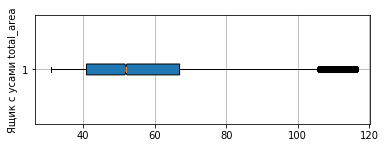

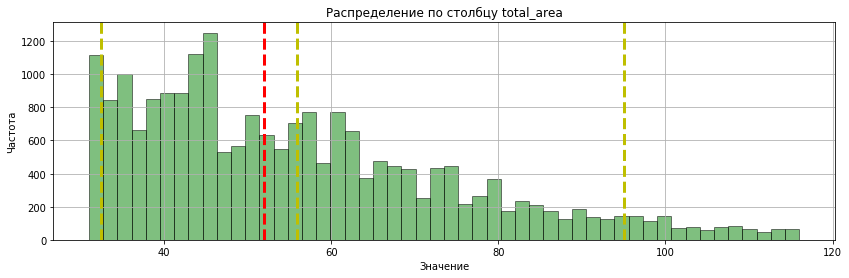

-----------------------------------------------------------


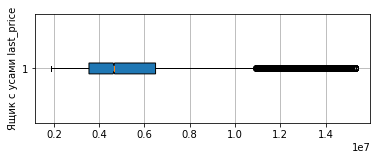

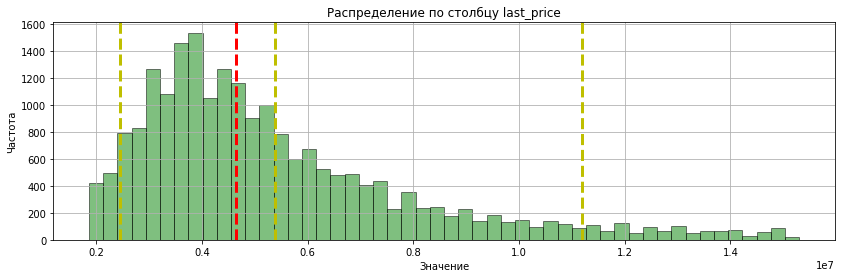

-----------------------------------------------------------


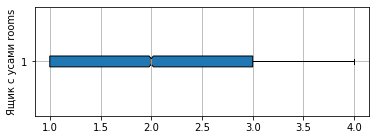

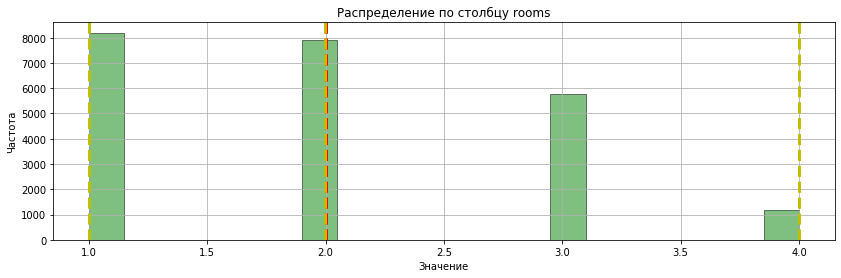

-----------------------------------------------------------


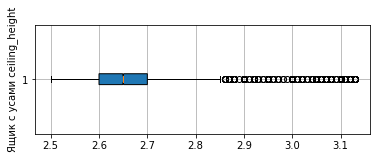

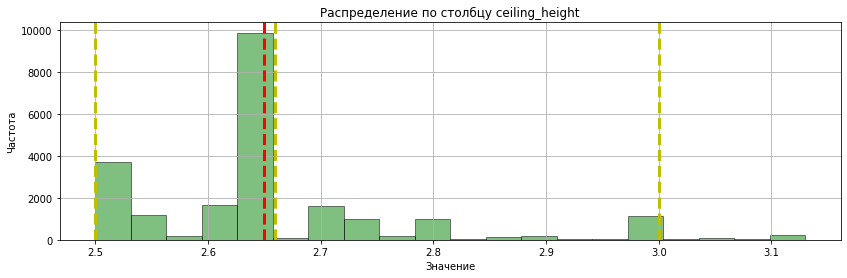

-----------------------------------------------------------


In [23]:
list_of_col=['total_area','last_price','rooms','ceiling_height']#построение графиков для заданных параметров
for every in list_of_col:
    my_hist(data,every)

Распределение в столбце total_area выглядит не совсем доброжелательно, оно не похоже ни на нормальное, ни на распределение Пуассона.Но может это и верно, видно, что есть некая зависимость между площадью и частотой -  чем больше площадь, тем меньше квартир с такой площадью. Это логично, Питер - второй по величине город в России, население здесь в среднем молодое, очень много студентов, в связи с этим в городе очень много студий и небольших квартир. Ведь студенту, да и вообще человеку пока без семьи не нужна большая квартира, это просто не имеет смысла. Очень много иногородних студентов учаться в местных вузах, а потом и остаются тут жить, так что студии и небольшие однокомнатные квартиры имеют спрос. Так же это логично, потому что такие квартиры дешевле. Если вспомнить построенную нами ранее таблицу корреляции, то там четко видно, что площадь сильнее всего коррелирует с ценой и количеством комнат, что только подтверждает сделанные выше выводы. То, что на графике есть небольшие скачки в районе 45-50 кв.м. сложно объяснить, скорее всего тут нет особо зависимости, застройщики строят десятки домов каждый год и увидеть логику в том, как они выбирают метраж - это не наша сегодняшняя задача. 

Распределение по столбцу 'last_price' похоже на нормальное, со смещением влево. Это хороший показатель, значит с данными в этом столбц все в порядке. Пик приходится на цену где-то в 3,7-4 миллиона - это коррелирует с данными о площадях, можно сделать предварительный вывод, что студии и однокомнатные квартиры в среднем стоят 3,7-4 млн. 

Распределение по столбцу "rooms" выглядит просто и понятно, больше всего однокомнатных и двухкомнатных квартир, далее идут трехкомнатные и четерыхкомнатные, выбросов особо нет, все хорошо и красиво.

С столбцом 'ceiling_height' сложно увидеть какую-то зависимость, разве что больше всего квартир с высотой потолков 2,65 - это стандарт, тут медиана и среднее значение совпадают с пиком графика, вот бы везде так... Дальше в зависимости от застройщика(скорее всего) и года постройки и местности высота потолков может меняться. Но крайне высокие значения встречаются реже всего, квартиры с потолками больше трех метров - большая редкость, а пик на 3м - это скорее всего квартиры в старых домах питербурга, в тех самых, где подъезд заслуженно называют парадной)


В целом из этих графиков можно сделать несколько по началу неочевидных выводов. Больше всего в питере продается небольших одна- и двухкомнатных квартир площадь которых в среднем колблется от 20 до 50 кв.м., а цена в среднем 3,8 млн рублей.

#### Изучаем время продажи квартиры

Изучим время продажи квартиры. Построим гистограмму. Посчитаем среднее и медиану. Опишем сколько в среднем занимает продажа квартиры, какую продажу можно считать очень быстрой, а какую затянувшейся. 


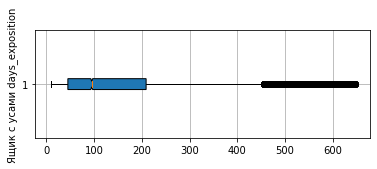

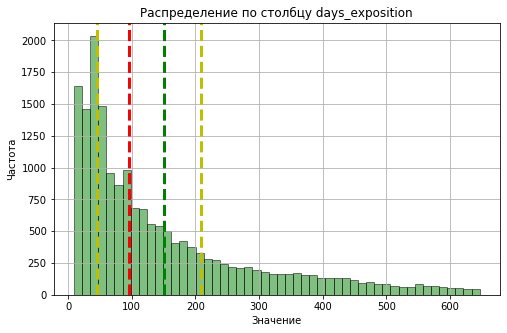

quantile .25:  45.00000000000001
quantile .75 231.0
180.7413945278023
95.0


In [24]:
#немного изменим функцию my_hist, раньше на графике прочерчивались 0.05 и 0.95 кваниль
#теперь же будет показываться 1 и 3 квартиль
def other_hist(data,col):
    my_col=data.loc[(data[col]>=data[col].quantile(.05))&(data[col]<=data[col].quantile(.95)),col]
    plt.figure(figsize=(6,2))
    plt.boxplot(my_col,# ящик с усами
               notch=True,
               sym="o",
               vert=False,
               widths=0.1,
               patch_artist=True)
    plt.ylabel('Ящик с усами '+ col)
    plt.grid()
    plt.show()
    plt.figure(figsize=(8,5))
    hist=my_col.plot(kind='hist',
                    bins=num_of_bins(data,col),
                    alpha=0.5,
                    ec='black',
                    color='green')
    plt.axvline(x=my_col.median(),
               linewidth=3,
               color='red',
               linestyle='--')
    plt.axvline(x=my_col.mean(),
               linewidth=3,
               color='g',
               linestyle='--')
    plt.axvline(x=my_col.quantile(.25),
               linewidth=3,
               color='y',
               linestyle='--')
    plt.axvline(x=my_col.quantile(.75),
               linewidth=3,
               color='y',
               linestyle='--')
    plt.title('Распределение по столбцу '+col)
    plt.xlabel('Значение')
    plt.ylabel('Частота')
    plt.grid()
    plt.show() 
other_hist(data,'days_exposition')
print('quantile .25: ', data['days_exposition'].quantile(.25))
print('quantile .75',data['days_exposition'].quantile(.75))
print(data['days_exposition'].mean())
print(data['days_exposition'].median())



По ящику с усами и гистограмме можно сказать, что слишком быстрыми продажами можно считать те, что уложились до первого квартиля распределения - это до 45 дней, всё что выше 75%, то есть третьего квартиля - это долгие продажи, те значения, что располагаются дальше правого уса нашего ящика с усами - выбросы, которые могу повлиять на анализ, отброисим их методом query(), если посмотреть на ящик с усами, то выбросы начинаются около 450.


In [25]:

data=data.query('days_exposition<450')

В среднем продажи занимают 180 дней, хотя чаще всего квартиры продают в среднем за 45-50 дней- этот вывод можно сделать из графика, поэтому при работе с этим столбцом лучше опираться на медиану, она ближе к пику гистограммы.

#### Убираем редкие и выбивающиеся значения


Посмотрим на данные о значениях в таблице методом describe(), чтобы отследить аномалии и выбросы


In [26]:
data.describe()

,total_images,last_price,total_area,rooms,ceiling_height,floors_total,living_area,floor,kitchen_area,balcony,...,parks_nearest,ponds_around3000,ponds_nearest,days_exposition,cost_for_meter,week_day_published,month_published,year_published,living_to_total_area,kitchen_to_total_area
count,18288.000000,1.828800e+04,18288.000000,18288.000000,18288.000000,18288.000000,18288.000000,18288.000000,18288.000000,18288.000000,...,6082.000000,14096.000000,6900.000000,18288.000000,1.828800e+04,18288.000000,18288.000000,18288.000000,18288.000000,18288.000000
mean,9.704779,6.037481e+06,57.575519,2.001422,2.710367,10.947069,32.882906,6.016514,10.247682,0.599738,...,489.733805,0.739926,527.026087,119.993985,9.731905e+04,2.592848,6.601761,2017.384569,0.564012,0.192674
std,5.670714,1.068471e+07,32.588098,1.015114,1.005531,6.672804,20.178251,4.953400,5.234120,0.951612,...,339.011383,0.917705,276.674469,109.610600,4.648772e+04,1.788364,3.489210,0.827969,0.104523,0.072429
min,0.000000,1.219000e+04,12.000000,1.000000,1.000000,1.000000,2.000000,1.000000,2.000000,0.000000,...,1.000000,0.000000,13.000000,1.000000,1.110000e+02,0.000000,1.000000,2015.000000,0.021583,0.025381
25%,6.000000,3.380000e+06,39.000000,1.000000,2.600000,5.000000,18.100000,2.000000,7.200000,0.000000,...,287.000000,0.000000,305.750000,40.000000,7.647000e+04,1.000000,3.000000,2017.000000,0.495929,0.139564
50%,9.000000,4.500000e+06,50.000000,2.000000,2.650000,9.000000,29.500000,4.000000,9.000000,0.000000,...,453.000000,0.000000,516.000000,81.000000,9.395400e+04,3.000000,7.000000,2017.000000,0.566667,0.178571
75%,14.000000,6.341000e+06,66.100000,3.000000,2.700000,16.000000,40.400000,8.000000,11.500000,1.000000,...,613.000000,1.000000,738.000000,173.000000,1.117372e+05,4.000000,10.000000,2018.000000,0.634615,0.236111
max,50.000000,7.630000e+08,900.000000,19.000000,100.000000,60.000000,409.700000,33.000000,112.000000,5.000000,...,3190.000000,3.000000,1344.000000,449.000000,1.907500e+06,6.000000,12.000000,2019.000000,1.335042,0.787879


В столбцах ['total_images','total_area','rooms','ceiling_height','floors_total','living_area','floor','kitchen_area','parks_nearest','ponds_nearest','days_exposition','living_to_total_area'] видна значительная разница между 3 квартилем и максимумом. Давайте взглянем на ящики с усами для этих столбцов. 

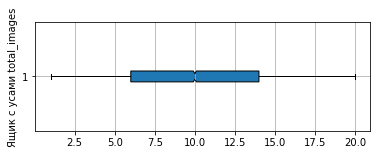

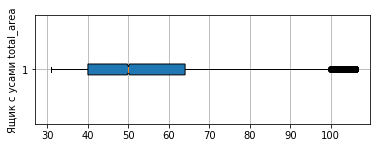

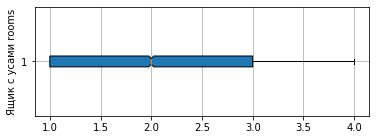

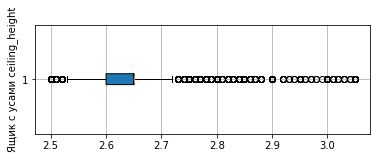

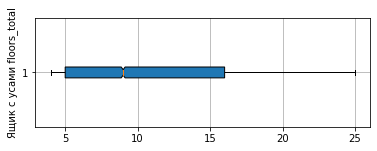

...

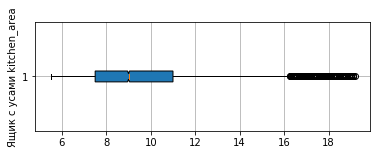

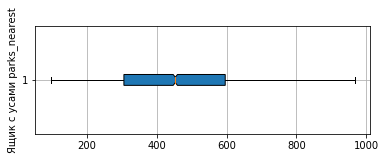

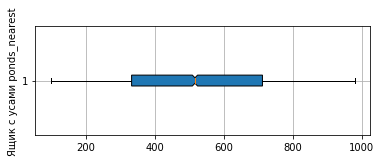

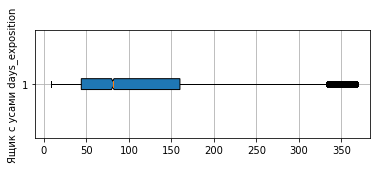

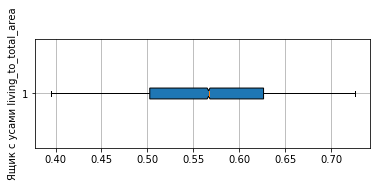

In [27]:
other_cols=['total_images','total_area','rooms','ceiling_height','floors_total','living_area','floor','kitchen_area','parks_nearest','ponds_nearest','days_exposition','living_to_total_area']
def boxplot(data,col):
    my_col=data.loc[(data[col]>=data[col].quantile(.05))&(data[col]<=data[col].quantile(.95)),col]
    plt.figure(figsize=(6,2))
    plt.boxplot(my_col,# ящик с усами
               notch=True,
               sym="o",
               vert=False,
               widths=0.1,
               patch_artist=True)
    plt.ylabel('Ящик с усами '+ col)
    plt.grid()
    plt.show()
for every in other_cols:
    boxplot(data,every)

Посмотрев на графики можно заметить несколько аномалий и убрать из данных редкие и аномальные значения. 
Например, в столбце 'total_images' убрирать всё, что выходит за пределы 1 м 3 квартиля будет слишком грубым, но можно безболезнено убрать значения, находящиеся за пределами усов, чтобы избавиться от скачков и увидеть на графике нормальное распределение.

Увидеть какую-то зависимость в столбце 'floors_total' сложно. Это может быть связяно с тем, что Санкт-Петербург город с большой историей, в котором сочетаются невысокие здания в центре города, многоэтажные дома в спальных районах, 9-10 этажные жилые комплексы на том же Васильевском острове. Уберем данные выходящие за пределы 1,5 межквартильных размахов.

Распределние по столбцу 'living_area' выглядит весьма подозрительно, как нормальное распределение с двумя пиками. Удалить строки с маленькой площадью - потерять большинство квартир, как мы поняли раньше маленькие квартиры - основной тип недвижимости в спб, поэтому удалять эти данные никак нельзя. Но можно удалть выбросы, слишком большие или слишком маленькие площади. Это может весьма облегчить нам работу с данными. 


С площадью кухни похожая беда, но там гистограмма больше выглядит как пульс человека, пробежавшего марафон, то есть резкие скачки и спады. Гистограмма отдельно по этому столбцу не дает особо полезной информации, потому что площадь кухни очень связана с жилой площадью и в студиях, например, вообще не разделяется площадь кухни и остальной комнаты, поэтому в столбцах с очень большой частотой могут быть как кухни из больших квартир, так и кухни из студий, чья площадь по ошибке была указана как площадь всей квартиры. Проведем те же манипуляции, что и с жилой площадью.


Во всех столбцах, что мы рассматриваем можно и даже нужно удалить выбросы и аномалии. Сделаем это ниже и посмотрим на результат.



In [28]:
def clear_data(data,col):
    #удаляем выбросы
    first_quartile = data[col].quantile(.25)
    third_quartile = data[col].quantile(.75) 
    iqr_df = third_quartile - first_quartile 
    data[col] = data[col][(data[col] > (first_quartile - 1.5 * iqr_df)) &
            (data[col] < (third_quartile + 1.5 * iqr_df))]
need_clear_list=['total_images', 'last_price', 'cost_for_meter', 'total_area','rooms','ceiling_height','floors_total','living_area','floor','kitchen_area','parks_nearest','ponds_nearest','days_exposition','living_to_total_area']
for every in need_clear_list:
    clear_data(data,every)
    
data.describe()

,total_images,last_price,total_area,rooms,ceiling_height,floors_total,living_area,floor,kitchen_area,balcony,...,parks_nearest,ponds_around3000,ponds_nearest,days_exposition,cost_for_meter,week_day_published,month_published,year_published,living_to_total_area,kitchen_to_total_area
count,18258.000000,1.683300e+04,17378.000000,18182.000000,16379.000000,18265.000000,17641.000000,17352.000000,17186.000000,18288.000000,...,5843.000000,14096.000000,6900.000000,17456.000000,17448.000000,18288.000000,18288.000000,18288.000000,18082.000000,18288.000000
mean,9.667543,4.631717e+06,52.400924,1.972500,2.631842,10.914426,30.306448,5.253054,9.293779,0.599738,...,440.000685,0.739926,527.026087,106.169970,92774.079952,2.592848,6.601761,2017.384569,0.564240,0.192674
std,5.593112,1.986061e+06,17.745648,0.932289,0.079277,6.609755,12.935116,3.750687,2.765630,0.951612,...,215.905268,0.917705,276.674469,91.446848,26749.398556,1.788364,3.489210,0.827969,0.098406,0.072429
min,0.000000,1.219000e+04,12.000000,1.000000,2.460000,1.000000,2.000000,1.000000,2.000000,0.000000,...,1.000000,0.000000,13.000000,1.000000,23592.000000,0.000000,1.000000,2015.000000,0.288221,0.025381
25%,6.000000,3.290000e+06,38.500000,1.000000,2.600000,5.000000,18.000000,2.000000,7.000000,0.000000,...,280.000000,0.000000,305.750000,37.000000,76310.250000,1.000000,3.000000,2017.000000,0.497552,0.139564
50%,9.000000,4.290000e+06,48.100000,2.000000,2.650000,9.000000,29.000000,4.000000,8.900000,0.000000,...,441.000000,0.000000,516.000000,74.000000,93181.000000,3.000000,7.000000,2017.000000,0.566667,0.178571
75%,14.000000,5.700000e+06,63.000000,3.000000,2.650000,16.000000,39.000000,7.000000,11.000000,1.000000,...,592.000000,1.000000,738.000000,156.000000,109502.500000,4.000000,10.000000,2018.000000,0.633720,0.236111
max,25.000000,1.075000e+07,106.700000,5.000000,2.850000,29.000000,73.600000,16.000000,17.900000,5.000000,...,1098.000000,3.000000,1344.000000,372.000000,164531.000000,6.000000,12.000000,2019.000000,0.842396,0.787879


Теперь данные выглядят намного лучше, без резких выбросов и аномалий. 

#### Факторы, влияющие на стоимость

Пришло время узнать какие факторы больше всего вляют на стоимость квартиры. Сделать это можно проследив уровень корреляции и построив диаграмму рассеяния для стоимости и других параметров - площади, числа комнат, удаленности от центра, этажа и как стоимость зависит от даты размещения заявления.


In [30]:
data.corr().style.background_gradient('coolwarm')

,total_images,last_price,total_area,rooms,ceiling_height,floors_total,living_area,floor,is_apartment,studio,open_plan,kitchen_area,balcony,airports_nearest,cityCenters_nearest,parks_around3000,parks_nearest,ponds_around3000,ponds_nearest,days_exposition,cost_for_meter,week_day_published,month_published,year_published,living_to_total_area,kitchen_to_total_area
total_images,1,0.153555,0.116003,0.0858263,-0.000256616,0.00902548,0.102079,0.0407501,0.0157715,-0.0282317,-0.0242336,0.0630641,0.0411671,0.00295374,-0.0413153,0.026743,-0.0137175,-0.0047695,-0.00995584,0.0359302,0.134163,-0.00977795,0.0212146,0.112326,-0.0102133,-0.0428831
last_price,0.153555,1,0.679665,0.443176,0.22219,0.202765,0.556927,0.148718,0.0167272,-0.0733241,-0.052725,0.456285,0.0780137,0.0181378,-0.210544,0.0997003,0.00910312,0.122302,-0.047132,0.0414638,0.565861,-0.0101767,0.00537782,0.00681714,0.0424838,-0.176169
total_area,0.116003,0.679665,1,0.792342,0.148528,-0.0171957,0.902979,-0.0101292,0.020834,-0.120298,-0.0768833,0.444147,0.0690664,-0.00458101,-0.126529,0.0857249,-0.00307715,0.114056,-0.0575529,0.0994167,-0.00668908,-0.010055,0.000322683,-0.0543667,0.252152,-0.441207
rooms,0.0858263,0.443176,0.792342,1,-0.0465685,-0.218403,0.881501,-0.142512,-0.00461512,-0.0864425,-0.0516103,0.10604,0.00748588,-0.0361539,-0.130516,0.102568,-0.0234653,0.0729527,-0.0408288,0.099151,-0.138365,0.0026701,-0.00103285,-0.0640727,0.535455,-0.623308
ceiling_height,-0.000256616,0.22219,0.148528,-0.0465685,1,0.322095,0.0330956,0.176065,0.0198765,0.0427811,0.0241194,0.397771,0.0903736,-0.0135093,-0.0971118,-0.0107356,0.0209355,0.0804407,-0.0541403,0.012611,0.20178,0.00968784,-0.00120905,-0.0968511,-0.240753,0.224159
floors_total,0.00902548,0.202765,-0.0171957,-0.218403,0.322095,1,-0.149388,0.583246,-0.023212,0.0703428,0.0509525,0.37297,0.175821,0.107102,0.00546511,-0.251663,0.117045,-0.138426,0.0676721,-0.0443716,0.329505,0.0122367,0.00866825,0.0164714,-0.366879,0.347957
living_area,0.102079,0.556927,0.902979,0.881501,0.0330956,-0.149388,1,-0.0935117,0.013996,-0.0755661,-0.0463527,0.219509,0.0366427,-0.025786,-0.128901,0.118324,-0.0193355,0.0975149,-0.0382599,0.102193,-0.0753391,-0.00327877,-0.000810473,-0.0587558,0.540779,-0.597986
floor,0.0407501,0.148718,-0.0101292,-0.142512,0.176065,0.583246,-0.0935117,1,-0.0164928,0.0280867,0.0145731,0.232299,0.171632,0.0586791,-0.0118344,-0.135945,0.0681126,-0.0629183,0.0390129,-0.0347587,0.244716,0.00855732,0.0102906,0.0165487,-0.241637,0.214724
is_apartment,0.0157715,0.0167272,0.020834,-0.00461512,0.0198765,-0.023212,0.013996,-0.0164928,1,-0.00340464,-0.00246101,0.0178296,0.0382856,0.0164749,0.0121374,0.0203514,-0.0269934,0.0229929,0.00170663,-0.0114811,0.0120762,-0.00622752,-0.004821,0.0274188,0.0049137,0.00686064
studio,-0.0282317,-0.0733241,-0.120298,-0.0864425,0.0427811,0.0703428,-0.0755661,0.0280867,-0.00340464,1,-0.0049346,-0.0269576,0.0298522,-0.0217927,-0.0101119,-0.0321115,0.00524941,0.00631996,0.00141042,-0.0279044,0.0420026,-0.00130898,-0.00183683,0.0123241,0.0886955,0.146741


In [31]:
def floor_type_int(data):
        if data['floor_type_str']=='Первый':
                return 0
        elif data['floor_type_str']=='Последний':
                return 2
        return 1 
#применим функцию 
data['floor_type_int'] = data.apply(floor_type_int,axis=1)

                cost_for_meter  floor_type_int  last_price     rooms  \
cost_for_meter        1.000000        0.155586    0.481891 -0.118332   
floor_type_int        0.155586        1.000000    0.136240  0.041289   
last_price            0.481891        0.136240    1.000000  0.422603   
rooms                -0.118332        0.041289    0.422603  1.000000   
total_area           -0.048758        0.002073    0.580358  0.735457   
year_published        0.137103       -0.036689   -0.108665 -0.379032   

                total_area  year_published  
cost_for_meter   -0.048758        0.137103  
floor_type_int    0.002073       -0.036689  
last_price        0.580358       -0.108665  
rooms             0.735457       -0.379032  
total_area        1.000000       -0.392574  
year_published   -0.392574        1.000000  
[[<matplotlib.axes._subplots.AxesSubplot object at 0x7f837295d110>


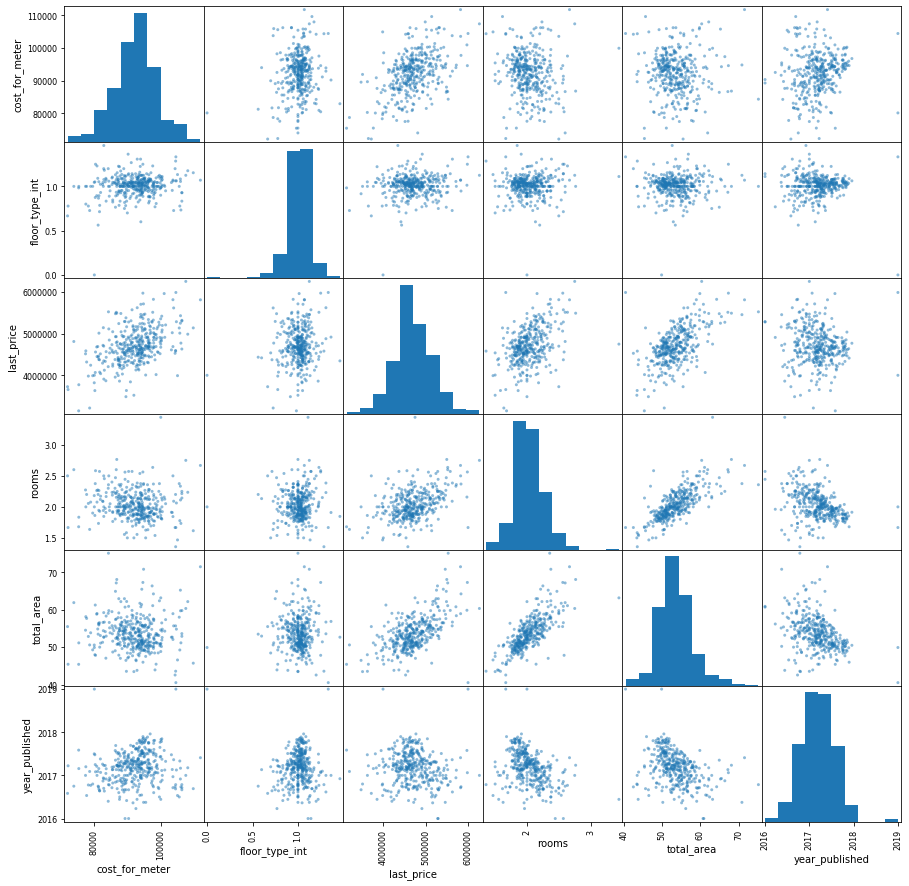

In [32]:
data_facts=data.pivot_table(index='days_exposition',values=['cost_for_meter','last_price','total_area','rooms','floor_type_int','year_published'],aggfunc='mean')
print(data_facts.corr())
print(pd.plotting.scatter_matrix(data_facts,figsize=(15,15)))
#как убрать вывод этого огромного массива или чего бы это ни было перед диаграмой рассеяния я не знаю((

По матрице корреляции видно, что конечная стоимость квартиры сильнее всего коррлерует с площадью, количеством комнат, так же есть небольшая положительная корреляция с типом этажа - первый, последний и другой. И отрицательная корреляция с годом публикации. Положительная корреляция показывает нам, что при увеличении одной величины, увеличивается вторая. Отрицательная же показывает обратную зависимость велечин. То есть чем позже было опубликовано объявление о продаже, тем дешевле была продана квартира. Это весьма странный факт, потому что обычно недвижимость растет в цене. 

Если взглянуть на диаграммы рассеяния, то можно заметить, что данные выглядят весьма сгрупированно. То есть большая часть точек находится в одной области и нет какой-то очевидной зависимости. Это в большинстве диаграмм. Но там где коэффициент корреляции достаточно большой, там видна зависимость, похожая на линейную. Видно как линейно зависят друг от друга цена и площадь, количество комнат и площад. Интересно, что данные весьма разбросаны в диаграмме рассеяния цена-количество комнат. То есть, конечно большинство данных сгрупированны и даже как будто бы имеют линейную зависимость похожую чем-то на y=2x, но те точки, что далеко от этой группы разбросаны хаотично. Бывают и очень дорогие 2 комнатные квартиры и весьма недорогие 3-х комнатные. 
Еще хочется обратить внимание на зависимость между столбцами с годом публикации объявления и количеством комнат и площадью, видно что чем позже выставлено объявление, тем меньше комнат и тем меньше площадь. Это опять-таки к теме студентов и студий. Приезжают студенты, покупают небольшие квартиры, живут несколько лет, потом продают.



после того как мы убрали выбросы, картина стала четче, но отрицательной корреляции между ценой за квадратный метр и комантами/площадью не нашлось. Давайте взглянем на графики в соответствии с категориальными признаками, такими как месяц и день. 


In [33]:
import plotly.express as px
def categorial(data,column,value):
    pivot=data.pivot_table(index=column,values=value,aggfunc='median').reset_index()
    fig=px.line(pivot,x=column,y=value,title='Зависимость '+column)
    fig.show('notebook')
categorial(data, 'week_day_published', 'last_price')
categorial(data, 'month_published', 'last_price')
categorial(data, 'year_published', 'last_price')
categorial(data, 'rooms', 'cost_for_meter')




Можно заметить весьма интересную, далеко не линейную зависимость между ценой и днем публикации объявления, резкие спады в пятницу и воскресение. 
Так же если посмотреть на зависимость между месяцем и ценой, то можно заметить, что к лету цены снижаются, а к весне растут. Это может быть объяснено тем, что летом многие уезжают из города в отпуска и так далее, а к осени как раз приезжают школьники, студенты и им всем нужно где-то жить. А как известно спрос пораждает предложение.
По графику зависимости цены от года публикации виден спад с 2016 по 2018 год. Это могут быть последствия кризиса 2014 года, так как структура экономики все эти годы продолжала ухудшаться, осложнилась международная обстановка. 
    
Так же начертим график завсимости цены за квадратный метр от числа комнат, потому что по диаграммам рассеяния не получилось отследить зависимость. На таком графике она четко видна.Теперь понятно почему не наблюдалось отрицательной корреляции, зависимость сложнее, чем линейная и большие значения компенсировались маленькими. Однокомнатные и двухкомнатные квартиры дороже, чем трехкомнатные, точнее у них выше цена за квадратный метр, дальше с увеличением комнат, цена за кв.м. растет. Это связано с тем, что одно- и двухкомнатные квартиры пользуются большим спросом.


In [34]:
# КОД РЕВЬЮВЕРА

# напишу функцию для группировки по категориальному признаку с подсчетом средней цены и отображением на линейном графике 


import plotly.express as px

def categorical(df, col_name, value):
    
    """
    df — датафрейм; col_name — колонка для группировки; value — признак для подсчета среднего
    """
    
    pivot = df.pivot_table(index = col_name, values = value, aggfunc = 'median').reset_index()
    
    fig = px.line(pivot, x = col_name, y = value, title = 'Зависимость с '+col_name)
    fig.show('notebook')
    
categorical(data, 'floor_type_str', 'last_price')

#### 10 населенных пунктов

In [35]:
data.groupby('locality_name')['rooms'].count().sort_values(ascending=False).head(10)


locality_name
Санкт-Петербург    12025
Мурино               505
Кудрово              398
Шушары               378
Всеволожск           301
Колпино              286
Парголово            281
Пушкин               272
Гатчина              240
Выборг               187
Name: rooms, dtype: int64

Сохраним список населенных пунктов с самым большим количеством объявлений в список biggest

In [36]:
biggest=['Санкт-Петербург','Мурино','Кудрово','Шушары','Всеволожск','Пушкин','Колпино','Парголово','Гатчина','Выборг']
biggest_data=data.query('locality_name in @biggest')
print(biggest_data.groupby('locality_name')['cost_for_meter'].mean().sort_values(ascending=False))


locality_name
Санкт-Петербург    104330.219055
Пушкин             100119.103704
Кудрово             94527.180905
Парголово           89087.840426
Мурино              85946.817822
Шушары              77818.306878
Колпино             74790.679443
Гатчина             68716.042194
Всеволожск          66855.630000
Выборг              57222.618280
Name: cost_for_meter, dtype: float64


С помощью метода query создадим таблицу biggest_data, состояющую из данных по квартирам городов с самым большим количеством объявлений. Так же мы вывели список, отсортированный по средней цене за квадратный метр в каждом населенном пункте. На 1 месте, очевидно, Санкт-Петербург, дальше Пушкин, Кудрово и т.д.
Самое дорогое жилье в Санкт-Петербурге, самое дешевое в Выборге. Очень интересно, что самое дорогое жилье в Санкт-Петербурге(то есть в областном центре), а самое дешевое - в городе, который находиться дальше всего от Спб из перечисленных, но при этом на втором месте по цене недижимость стоят не Шушары или Мурино, а Пушкин, который находится дальше и там нет станций метро до центра спб, в отличие от Мурино и Шушар. 

#### Путешествие к центру Спб...

Создадим отдельную таблицу с объявлениями, сделанными только в Санкт-Петербурге. Переведем расстояние до центра в километры и расчитаем средние значения цены для каждого километра и посмотрим на график, чтобы выяснить, что же центр Спб, а что уже окраины.

cityCenters_nearest_km
0.0     7.141429e+06
1.0     7.614721e+06
2.0     7.600468e+06
3.0     6.674299e+06
4.0     7.037017e+06
5.0     7.087730e+06
6.0     6.705451e+06
7.0     6.274287e+06
8.0     6.142151e+06
9.0     5.282834e+06
10.0    5.145477e+06
11.0    5.102044e+06
12.0    5.130662e+06
13.0    5.285293e+06
14.0    5.076690e+06
15.0    5.101591e+06
16.0    4.909027e+06
17.0    4.747479e+06
18.0    4.462328e+06
19.0    4.705930e+06
20.0    5.452345e+06
21.0    5.066220e+06
22.0    4.970031e+06
23.0    4.662632e+06
24.0    3.835887e+06
25.0    4.052840e+06
26.0    3.989609e+06
27.0    2.250000e+06
28.0    5.026429e+06
29.0    3.833333e+06
Name: last_price, dtype: float64


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



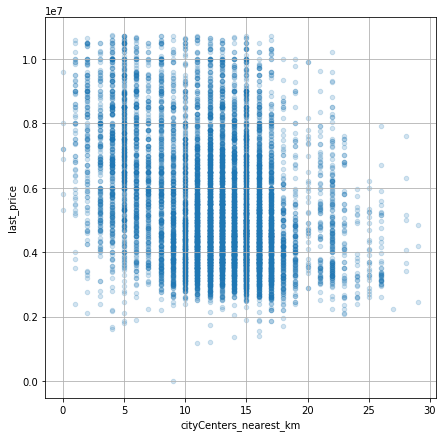

In [37]:
data_spb=data.query('locality_name=="Санкт-Петербург"')
data_spb['cityCenters_nearest_km']=round(data_spb['cityCenters_nearest']/1000)
print(data_spb.groupby('cityCenters_nearest_km')['last_price'].mean())
data_spb.plot(x='cityCenters_nearest_km',y='last_price',kind='scatter',grid=True,alpha=0.2,figsize=(7,7))
categorical(data_spb, 'cityCenters_nearest_km', 'last_price')


Можно заметить весьма резкий спад около 8 километров, значит, всё, что в радиусе 8 км от точки отсчета - центр культурной столицы. 

#### Квартиры в центре

Выделим квартиры в центре спб и посмотрим насколько эти данные отличаются от общей картины.

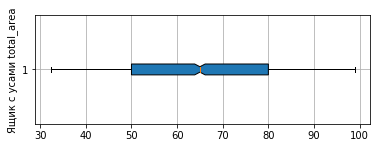

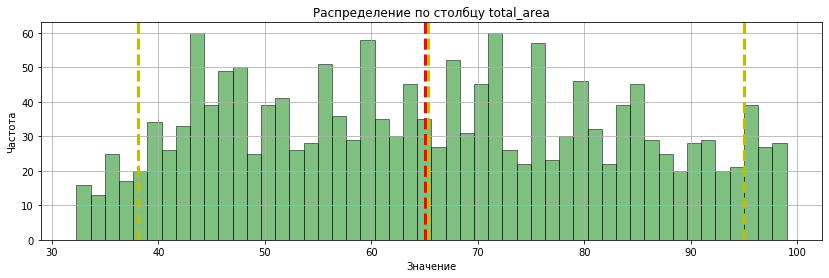

-----------------------------------------------------------


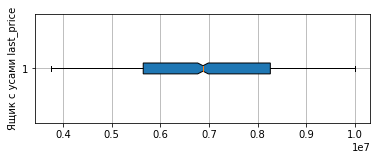

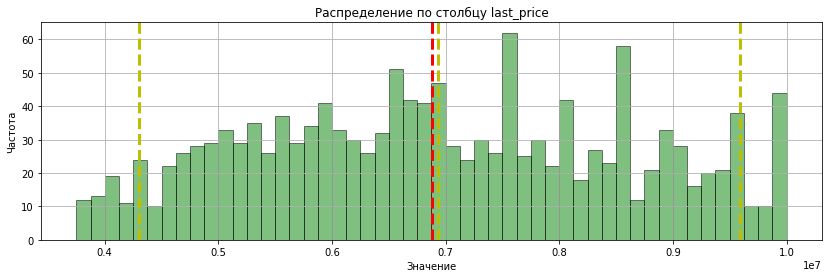

-----------------------------------------------------------


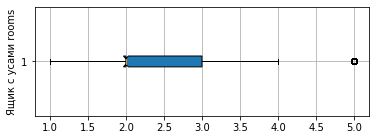

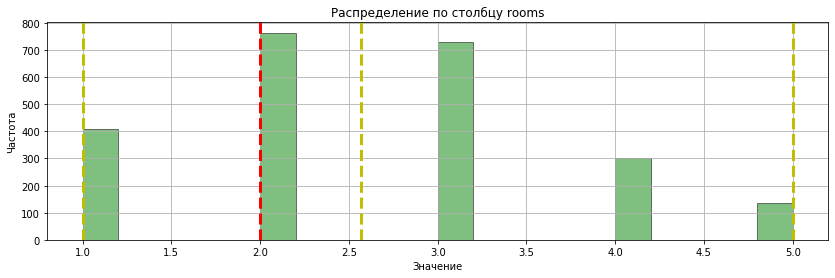

-----------------------------------------------------------


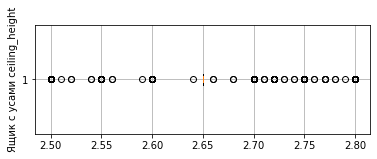

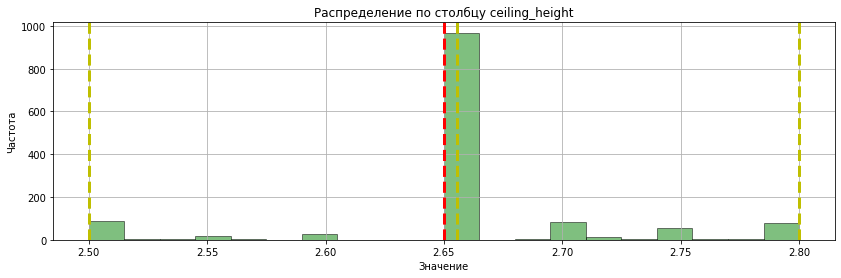

-----------------------------------------------------------


In [38]:
data_center=data_spb.query('cityCenters_nearest_km<8')
list_of_col=['total_area','last_price','rooms','ceiling_height']
for every in list_of_col:
    my_hist(data_center,every)

Распределение по площади куда больше похоже на нормальное, со сдвигом влево, причем большая часть квартир имеют площадь, которая может быть и у студии, и у 2-х комнатной квартиры. Распределение более чем нормальное. 
В столбце с ценой, после 1,5 млн идет достаточно резкий спад, и там частота очень близка к нулю. То есть в Спб не так много очень дорогих квартир. Хм...
Распределение по числу комнат выглядит как очень добропорядочное нормальное распределение, весьма наглядно показывающее, что больше всего 2-х и 3-х комнатных квартир продается в Спб.
Чаще всего высота потолков в райне 2,7 - это скорее всего новостройки и множество жилых комплексов, всплекс на 3м - квартиры в центре города, то есть прям совсем в центре, где здания еще достаточно старые.

Построим матрицу корреляции для наших данных и диаграммы рассеяния.

                    floor_type_int  last_price  month_published     rooms  \
floor_type_int            1.000000    0.149296        -0.086073  0.147204   
last_price                0.149296    1.000000        -0.133640  0.376477   
month_published          -0.086073   -0.133640         1.000000 -0.135840   
rooms                     0.147204    0.376477        -0.135840  1.000000   
week_day_published        0.044180    0.035599         0.036213  0.056284   
year_published           -0.037523   -0.117917        -0.087930 -0.115280   

                    week_day_published  year_published  
floor_type_int                0.044180       -0.037523  
last_price                    0.035599       -0.117917  
month_published               0.036213       -0.087930  
rooms                         0.056284       -0.115280  
week_day_published            1.000000        0.056972  
year_published                0.056972        1.000000  
[[<matplotlib.axes._subplots.AxesSubplot object at 0x7f836158

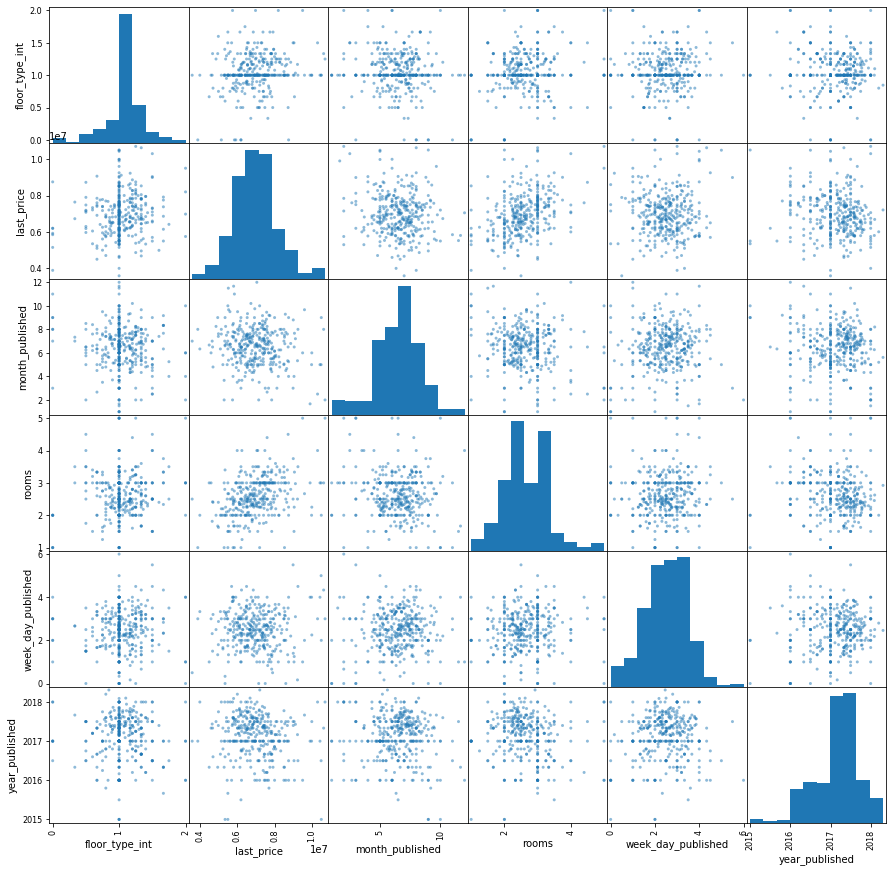

In [39]:
data_facts_center=data_center.pivot_table(index='days_exposition',values=['last_price','rooms','floor_type_int','week_day_published','month_published','year_published'],aggfunc='mean')
print(data_facts_center.corr())
print(pd.plotting.scatter_matrix(data_facts_center,figsize=(15,15)))

и для сравнения выведем данные по всему Сантк-Петербургу.

                    floor_type_int  last_price  month_published     rooms  \
floor_type_int            1.000000    0.053790         0.056113 -0.022591   
last_price                0.053790    1.000000         0.050195  0.499482   
month_published           0.056113    0.050195         1.000000 -0.015753   
rooms                    -0.022591    0.499482        -0.015753  1.000000   
week_day_published        0.039795    0.032382         0.131464  0.170610   
year_published           -0.060037   -0.271361        -0.031513 -0.335269   

                    week_day_published  year_published  
floor_type_int                0.039795       -0.060037  
last_price                    0.032382       -0.271361  
month_published               0.131464       -0.031513  
rooms                         0.170610       -0.335269  
week_day_published            1.000000       -0.018966  
year_published               -0.018966        1.000000  
[[<matplotlib.axes._subplots.AxesSubplot object at 0x7f836200

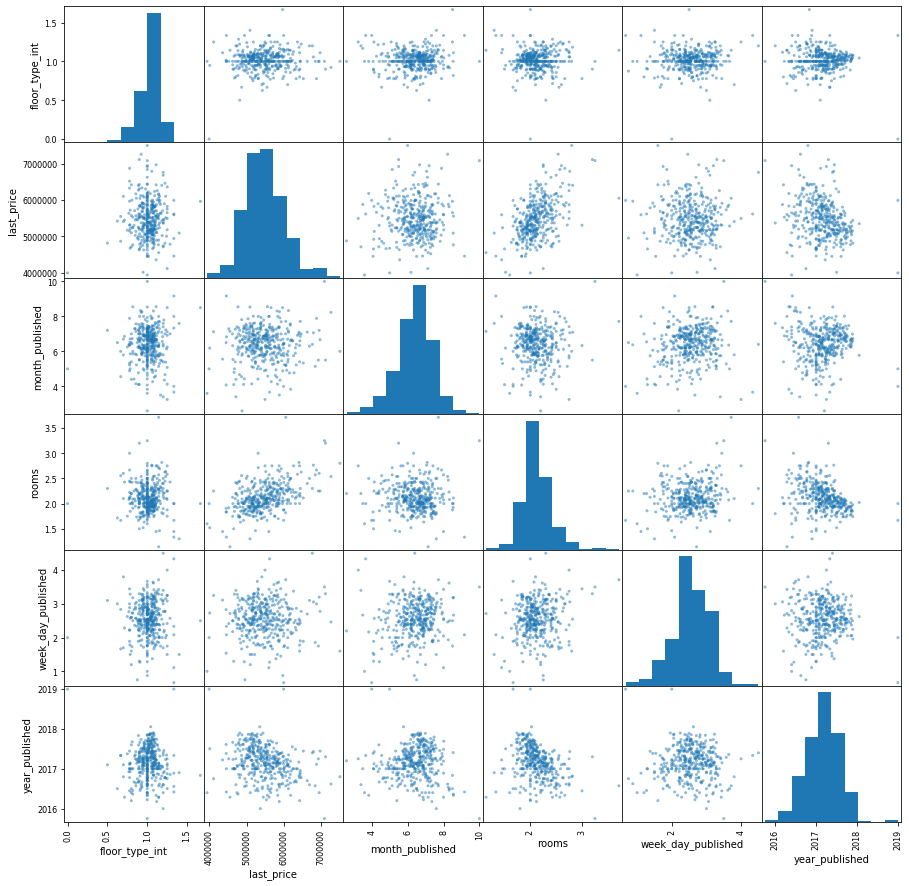

In [40]:
data_facts_center_spb=data_spb.pivot_table(index='days_exposition',values=['last_price','rooms','floor_type_int','week_day_published','month_published','year_published'],aggfunc='mean')
print(data_facts_center_spb.corr())
print(pd.plotting.scatter_matrix(data_facts_center_spb,figsize=(15,15)))

Данные для центра Санкт-Петебурга и  всего города весьма отличаются. Для всего города, например,, в столбце floor_type_int данные больше похожи упорядоченый в какой-то области хаос, в то время как для центра города почти везде вырисовыватся четкие линии, не без выбросов конечно. Данные по первому и последнему этажу не дают много информации, они разбросаны хаотично, но видно, что больше всего квартир на "другом" этаже и цены, площадь и все остальное варьируются у них от небольших до очень высоких. Так же видно, что в центре города очень много объявлений было сделано в 2017 году, с чем это может быть связано нужно посмотреть в сводках новостей за 2017. Так же можно заметить, что в центре города намного меньше квартир с большим количеством комнат, зависимоть кол-ва комнат от цены похоже на функцию корня, в то время как по всему спб больше напоминает линейную. 
Из глобальных и очень заментых отличий можно назвать то, что по всему спб данные более хаотично распределенные с увеличением числа точек(объявлений) где-то в центрах диаграмм, тогда как в центре данные более структирированные и последовательные. Ну и важно заметить, что распределения по цене отличаются. В центре почти нет недорогих квартир, в то время как по всему городу существуют и квартиры с ценой ниже среднего. 

In [41]:

spb_data = data.query('locality_name == "Санкт-Петербург"')

spb_data['type_center']= spb_data.loc[spb_data['cityCenters_nearest'] <= 8000, 'type_center']='сenter'
spb_data.loc[spb_data['cityCenters_nearest'] > 8000, 'type_center']='outside_center'

# типичные характеристики, пример

columns = ['total_area', 'last_price', 'rooms', 'ceiling_height']

for col in columns:
    
    fig = px.histogram(spb_data, x = col, marginal = 'box', color = 'type_center', title = 'Распределение '+col)
    fig.show()
    
# зависимость с категориальным, пример
    
fig = px.line(spb_data.pivot_table(index = ['type_center', 'floor_type_str'], values = 'last_price', aggfunc = 'median').reset_index(),
             x = 'floor_type_str', y = 'last_price', color = 'type_center')
fig.show()

# корреляция, пример
display(spb_data.pivot_table(index = 'type_center', values = columns, aggfunc = 'corr'))

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/opt/conda/lib/python3.7/site-packages/pandas/core/indexing.py:494: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



ceiling_height  last_price     rooms  \
type_center                                                           
outside_center total_area            0.166465    0.800563  0.780403   
               last_price            0.246493    1.000000  0.503209   
               rooms                -0.074403    0.503209  1.000000   
               ceiling_height        1.000000    0.246493 -0.074403   
сenter         total_area            0.118501    0.698664  0.755516   
               last_price            0.197884    1.000000  0.462446   
               rooms                 0.035466    0.462446  1.000000   
               ceiling_height        1.000000    0.197884  0.035466   

                               total_area  
type_center                                
outside_center total_area        1.000000  
               last_price        0.800563  
               rooms             0.780403  
               ceiling_height    0.166465  
сenter         total_area        1.000000  
               last_price        0.698664  
               rooms             0.755516  
               ceiling_height    0.118501

Добавим сравнение данных для квартир в центре и вне его по столбцам свзянным с датой публикации.

In [42]:
columns = ['week_day_published','month_published','year_published']
#почему-то через for не получилось сделать((
# зависимость с категориальным, пример
fig = px.line(spb_data.pivot_table(index = ['type_center', 'week_day_published'], values = 'last_price', aggfunc = 'median').reset_index(),
             x = 'week_day_published', y = 'last_price', color = 'type_center')
fig.show()
fig = px.line(spb_data.pivot_table(index = ['type_center', 'month_published'], values = 'last_price', aggfunc = 'median').reset_index(),
             x = 'month_published', y = 'last_price', color = 'type_center')
fig.show()
fig = px.line(spb_data.pivot_table(index = ['type_center', 'year_published'], values = 'last_price', aggfunc = 'median').reset_index(),
             x = 'year_published', y = 'last_price', color = 'type_center')
fig.show()


Видна большая разница в графике зависимости цены от месяца публикации. Видно, что за пределами центра цены более "усреднены" то есть линия больше похожа на прямую, незначительно меняется в зависимости от месяца. А вот в центре цены скачут, но прослеживается зависимость в том, что к лету все же цены спадают, в июне-августе поднимаются, а дальше скачут в промежутке от 8 до 9 млн. Зависимость от дня недели похожа по стабильноси для квартир вне центра, а в центре видно, что цены идут вниз в середине недели и поднимаются в конце.  С годом публикации зависимость интереснее всего, тк за пределами центра идет спад в цене квартир с 2016-2017 годах, в то время как в центре в это время цены только растут. Скорее всего просто эти спады и подъемы компенцирут друг друга. 


Так же давайте изучим зависимоть цены за квадратный метр от количества комнат, проверим будет ли отличатся этот показатель от того, что мы обнаружили ранее.

In [43]:
fig = px.line(spb_data.pivot_table(index = ['type_center', 'rooms'], values = 'cost_for_meter', aggfunc = 'median').reset_index(),
             x = 'rooms', y = 'cost_for_meter', color = 'type_center')
fig.show()



Как видно на графике, зависимости одинаковы, что для центра, что и за его пределами. Единственным отличием является то, что цена за кв.м. за пределами центра ниже, чем в центре. Но в этом нет ничего удивительного, мы можем наблюдать это на всех графиках. 
    
    


### Шаг 5. Общий вывод

Обработав данные, заполнив пропуски, удалив дубликаты, мы смогли проанализировать данные таблицы и получить определенные результаты. Цена квартиры зависит от площади и количества комнат. В Санкт-Петербурге очень много небольших квартир, особенно в центре города, самые популярные 1-2 комнатные квартиры, площадь таких квартир колеблеться от 35-до 50 кв метров, а цена достигает 3-3,5 млн рублей. В цетре города наблюдается небольшой всплекс продажи квартир а 2017 году. Больше всего объявлений о продаже недвижимости за данный период времени было в Санкт-Петербурге, дальше шел город Пушкин.

Цена квартиры так же зависит от этажа, но эта зависимоть не такая очевидная как от площади и количества комнат. Квартиры на крайних  этажах дешевле, чем на "других". Можно заметить небольшую зависимоть роста цены на квариру от месяца публикации, это называется сезонный рост цен на недвижимость. Достаточно сильно влияет местонахождение квартиры, чем ближе к центру, тем цены выше, но это не работает так для пригорода. Мурино и Шушары ближе к спб, чем Пушкин, но цена за квадратный метр там куда ниже. Это может быть связно с качеством недвжимости. Мурино и Шушары относительно новые районы, там новые дома, а качесто звукоизоляции и самих построек там сомнительное. Так же это просто спальные районы и там почти нет рабочих мест, все жители этих городов ездят в спб на работу. В Пушкине же ситуация немного другая. Это весьма самостотельный город со своей инфростурктурой и большим количетсвом рабочих мест. Этим можно объяснить такой разброс в стоимость кв.м. недвижимости в этих населенных пунктах.

Таким образом, можно сделать вывод, что основными факторами, влияющими на стоимость неджвижимости является площадь, количество комнат, местоположение и этаж. По всей Лен. области цена за квадратный метр выше всего в самом Петербурге, чем глубже в лес(чем дальше от центра), тем цена меньше. Хотя есть всплески на каких-то расстояниях, скорее всего это спальные районы, по типу Академической, Парнаса и т.д.Центром города можно считать все квартиры в радиусе 8 км от точки отсчета. Там зависимости примерно те же, но графики и диаграммы четче. Дешевых квартир там почти нет, цены колеблятся от 3 до 4 млн в среднем.

По ящику с усами и гистограмме можно сказать, что слишком быстрыми продажами можно считать те, что  случились до  45 дней, все продажы после 200 дней можно считать долгими. 

Так же если посмотреть на зависимость между месяцем и ценой, то можно заметить, что к лету цены снижаются, а к весне растут. Это может быть объяснено тем, что летом многие уезжают из города в отпуска и так далее, а к осени как раз приезжают школьники, студенты. А как известно спрос пораждает предложение. По графику зависимости цены от года публикации виден спад с 2016 по 2018 год. Это могут быть последствия кризиса 2014 года. 
Однако если рассматривать зависимости для квартир в центре и вне его, там наблюдается компенсация спадов и подъемов цены. За пределами центра идет спад в цене квартир с 2016-2017 годах, в то время как в центре в это время цены только растут. Скорее всего просто эти спады и подъемы компенцирут друг друга.

Однокомнатные и двухкомнатные квартиры дороже, чем трехкомнатные, точнее у них выше цена за квадратный метр, дальше с увеличением комнат, цена за кв.м. растет. Это связано с тем, что одно- и двухкомнатные квартиры пользуются большим спросом.

P.S. Спасибо за ценные советы, постаралась всё по максимуму сделать, что было в моих силах, если остались какие-то недочеты, то готова их исправлять. Спасибо, Андрей, за уделенное время!